In [1]:
#*****************************************************************************************************************************
#Project   : Path Finder                                                                                                     #
#Author    : Keerthi Kambam                                                                                                  #
#            Pavan Kumar Battula                                                                                             #
#Objective : The Main Objective of the project is to demonstrate the Q-Learning Model in finding the optimal path to reach   #
#the Goal State from any particular state in the Environment                                                                 #
#Approach  : 1)Design the path Grid(for Visualization)                                                                       #
#            2)Build Reward Matrix                                                                                           #
#            3)Build Q-Learning Model using Bellmen Equation                                                                 #
#            4)Build Q-Learning Model using Heuristic Fuction                                                                #
#            5)Compare the Perfomance of Both models                                                                         #
#            6)Evaluate the Metrics of the Q-Lerning Models                                                                  #
#*****************************************************************************************************************************

## Importing required libraries

In [2]:
import pandas as pd
import random
import numpy as np
import matplotlib.pyplot as plt

## Grid environment where the agent is to be trained 
- There were 10 states and 1 Goal state in the grid for the agent to learn 

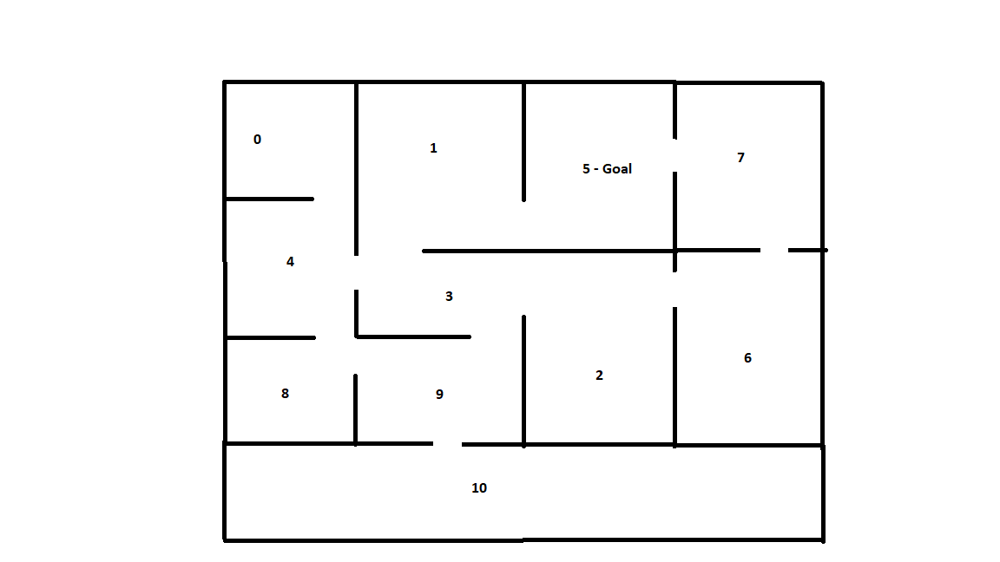

## Creating the reward matrix for each state and action in the grid

In [3]:
rewards = np.array([[-1,-1,-1,-1,0,-1,-1,-1,-1,-1,-1],
                   [-1,-1,-1,0,-1,100,-1,-1,-1,-1,-1],
                    [-1,-1,-1,0,-1,-1,0,-1,-1,-1,-1],
                    [-1,0,0,-1,0,-1,-1,-1,-1,0,-1],
                    [0,-1,-1,0,-1,-1,-1,-1,0,-1,-1],
                    [-1,0,-1,-1,-1,-1,-1,0,-1,-1,-1],
                    [-1,-1,0,-1,-1,-1,-1,0,-1,-1,-1],
                    [-1,-1,-1,-1,-1,0,0,-1,-1,-1,-1],
                    [-1,-1,-1,-1,0,-1,-1,-1,-1,0,-1],
                    [-1,-1,-1,0,-1,-1,-1,-1,0,-1,0],
                    [-1,-1,-1,-1,-1,-1,-1,-1,-1,0,-1]])

pd.DataFrame(rewards)

,0,1,2,3,4,5,6,7,8,9,10
0,-1,-1,-1,-1,0,-1,-1,-1,-1,-1,-1
1,-1,-1,-1,0,-1,100,-1,-1,-1,-1,-1
2,-1,-1,-1,0,-1,-1,0,-1,-1,-1,-1
3,-1,0,0,-1,0,-1,-1,-1,-1,0,-1
4,0,-1,-1,0,-1,-1,-1,-1,0,-1,-1
5,-1,0,-1,-1,-1,-1,-1,0,-1,-1,-1
6,-1,-1,0,-1,-1,-1,-1,0,-1,-1,-1
7,-1,-1,-1,-1,-1,0,0,-1,-1,-1,-1
8,-1,-1,-1,-1,0,-1,-1,-1,-1,0,-1
9,-1,-1,-1,0,-1,-1,-1,-1,0,-1,0


## Initialising the q-matrix with zeroes

In [4]:
def initialize_q(m,n):
    return np.zeros((m,n))

q_matrix = initialize_q(11,11)
pd.DataFrame(q_matrix)

,0,1,2,3,4,5,6,7,8,9,10
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [5]:
def normalize_matrix(q_matrix):
    normalized_q = q_matrix/max(q_matrix[q_matrix.nonzero()]) * 100
    return normalized_q.astype(int)

In [6]:
def set_initial_state(rooms = 11):
    return np.random.randint(0,rooms)

## Simple Q-Learning Model Building to reach Goal State(i.e. 5)

In [7]:
def train_agent(episode):
    gamma=0.8
    Time_step = 0
    current_state = set_initial_state()

    while True:
        valid_actions = []
        for action in enumerate(rewards[current_state]):
            if action[1]!= -1:
                valid_actions +=[action[0]]
        action = random.choice(valid_actions)
        cur_state_reward= rewards[current_state, action] 
        nxt_state_reward= max(q_matrix[action,])
        q_current_state= cur_state_reward+(gamma*nxt_state_reward)
        q_matrix[current_state, action]=q_current_state 
        new_state= action
        print(q_matrix)
        print(f"Old State: {current_state} | New State: {new_state}\n\n")
        current_state = new_state
        Time_step = Time_step +1

        if new_state== 5:
            print(f"Agent has reached it's goal!")
            print(f"The Total Timesteps took by Agent for this episode {episode} is",Time_step)
            break
    return Time_step,q_matrix

## Full training for the Agent

In [8]:
iterations = 500
Total_steps = 0
Learning_step_bi = []
rewards_curve_bi = []
for episode in range(1,iterations):
    steps,q_matrix = train_agent(episode) 
    rewards_curve_bi.append(np.sum(q_matrix))
    Learning_step_bi.append(Total_steps + steps)
    Total_steps = Total_steps + steps
print("Total Steps for full learning Process:",Total_steps)

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
Old State: 2 | New State: 3


[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
Old State: 3 | New State: 2


[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [

    0.  ]]
Old State: 4 | New State: 3


[[  0.     0.     0.     0.    51.2    0.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.    64.     0.   100.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.    64.     0.     0.    40.96   0.     0.     0.
    0.  ]
 [  0.    80.    51.2    0.    51.2    0.     0.     0.     0.    51.2
    0.  ]
 [  0.     0.     0.    64.     0.     0.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.     0.     0.     0.     0.     0.     0.     0.
    0.  ]
 [  0.     0.    51.2    0.     0.     0.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.     0.     0.     0.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.     0.    51.2    0.     0.     0.     0.    51.2
    0.  ]
 [  0.     0.     0.    64.     0.     0.     0.     0.    40.96   0.
   40.96]
 [  0.     0.     0.     0.     0.     0.     0.     0.     0.    51.2
    0.  ]]
Old State: 3 | New State: 1


[[  0.     0.     0.     0.    51.2    0.    

   51.2     0.   ]]
Old State: 7 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 12 is 20
[[  0.      0.      0.      0.     51.2     0.      0.      0.      0.
    0.      0.   ]
 [  0.      0.      0.     64.      0.    100.      0.      0.      0.
    0.      0.   ]
 [  0.      0.      0.     64.      0.      0.     40.96    0.      0.
    0.      0.   ]
 [  0.     80.     51.2     0.     51.2     0.      0.      0.      0.
   51.2     0.   ]
 [ 40.96    0.      0.     64.      0.      0.      0.      0.     40.96
    0.      0.   ]
 [  0.      0.      0.      0.      0.      0.      0.      0.      0.
    0.      0.   ]
 [  0.      0.     51.2     0.      0.      0.      0.     32.768   0.
    0.      0.   ]
 [  0.      0.      0.      0.      0.      0.     40.96    0.      0.
    0.      0.   ]
 [  0.      0.      0.      0.     51.2     0.      0.      0.      0.
   51.2     0.   ]
 [  0.      0.      0.     64.      0.      0.   

    0.        ]]
Old State: 8 | New State: 9


[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          64.           0.
    0.          40.96         0.           0.           0.
    0.        ]
 [  0.         100.97152     51.2          0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 40.96         0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          51.2          0.           0.
    0.           0.          32.768        0.           0.
    0.    

    0.        ]]
Old State: 9 | New State: 3


[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         100.97152     64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          64.6217728    0.           0.
    0.           0.          32.768        0.           0.
    0.    

Old State: 9 | New State: 3


[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         100.97152     64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          64.6217728    0.           0.
    0.           0.          41.35793459   0.           0.
    0.        ]
 [  0.     

    0.        ]]
Old State: 7 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 31 is 28
[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         100.97152     64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          64.6217728

    0.        ]]
Old State: 1 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 33 is 38
[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         100.97152     64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          64.6217728

    0.        ]]
Old State: 9 | New State: 3


[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         100.97152     64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          64.6217728    0.           0.
    0.           0.          41.35793459   0.           0.
    0.    

    0.        ]]
Old State: 4 | New State: 8


[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         100.97152     64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          64.6217728    0.           0.
    0.           0.          41.35793459   0.           0.
    0.    

    0.        ]]
Old State: 4 | New State: 0


[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         100.97152     64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          64.6217728    0.           0.
    0.           0.          41.35793459   0.           0.
    0.    

Old State: 4 | New State: 3


[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  126.2144       0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         100.97152     64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.           0.           0.           0.           0.
    0.           0.          32.768        0.           0.
    0.        ]
 [  0.           0.          64.6217728    0.           0.
    0.           0.          41.35793459   0.           0.
    0.        ]
 [  0.     

    0.        ]]
Old State: 0 | New State: 4


[[  0.           0.           0.           0.          64.6217728
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
  180.777216     0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.          80.777216     0.
    0.          51.69741824   0.           0.           0.
    0.        ]
 [  0.         144.6217728   64.6217728    0.          64.6217728
    0.           0.           0.           0.          64.6217728
    0.        ]
 [ 51.69741824   0.           0.          80.777216     0.
    0.           0.           0.          51.69741824   0.
    0.        ]
 [  0.         100.97152      0.           0.           0.
    0.           0.          41.35793459   0.           0.
    0.        ]
 [  0.           0.          64.6217728    0.           0.
    0.           0.          41.35793459   0.           0.
    0.    

    0.        ]]
Old State: 3 | New State: 2


[[  0.           0.           0.           0.          92.55793459
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         115.69741824   0.
  180.777216     0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         115.69741824   0.
    0.          74.04634767   0.           0.           0.
    0.        ]
 [  0.         144.6217728   92.55793459   0.          92.55793459
    0.           0.           0.           0.          92.55793459
    0.        ]
 [ 74.04634767   0.           0.         115.69741824   0.
    0.           0.           0.          74.04634767   0.
    0.        ]
 [  0.         100.97152      0.           0.           0.
    0.           0.          41.35793459   0.           0.
    0.        ]
 [  0.           0.          92.55793459   0.           0.
    0.           0.          64.6217728    0.           0.
    0. 

    0.        ]]
Old State: 9 | New State: 8


[[  0.           0.           0.           0.          92.55793459
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         115.69741824   0.
  180.777216     0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         115.69741824   0.
    0.          74.04634767   0.           0.           0.
    0.        ]
 [  0.         144.6217728   92.55793459   0.          92.55793459
    0.           0.           0.           0.          92.55793459
    0.        ]
 [ 74.04634767   0.           0.         115.69741824   0.
    0.           0.           0.          74.04634767   0.
    0.        ]
 [  0.         100.97152      0.           0.           0.
    0.           0.          41.35793459   0.           0.
    0.        ]
 [  0.           0.          92.55793459   0.           0.
    0.           0.          64.6217728    0.           0.
    0. 

The Total Timesteps took by Agent for this episode 65 is 15
[[  0.           0.           0.           0.          92.55793459
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         138.04634767   0.
  215.69741824   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         115.69741824   0.
    0.          74.04634767   0.           0.           0.
    0.        ]
 [  0.         172.55793459  92.55793459   0.          92.55793459
    0.           0.           0.           0.          92.55793459
    0.        ]
 [ 74.04634767   0.           0.         138.04634767   0.
    0.           0.           0.          74.04634767   0.
    0.        ]
 [  0.         144.6217728    0.           0.           0.
    0.           0.          41.35793459   0.           0.
    0.        ]
 [  0.           0.          92.55793459   0.           0.
    0.           0.          64.6217728    0.        

    0.        ]]
Old State: 4 | New State: 8


[[  0.           0.           0.           0.         110.43707814
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         138.04634767   0.
  215.69741824   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         138.04634767   0.
    0.          88.34966251   0.           0.           0.
    0.        ]
 [  0.         172.55793459 110.43707814   0.         110.43707814
    0.           0.           0.           0.         110.43707814
    0.        ]
 [ 88.34966251   0.           0.         138.04634767   0.
    0.           0.           0.          88.34966251   0.
    0.        ]
 [  0.         144.6217728    0.           0.           0.
    0.           0.          41.35793459   0.           0.
    0.        ]
 [  0.           0.         110.43707814   0.           0.
    0.           0.          92.55793459   0.           0.
    0. 

    0.        ]]
Old State: 7 | New State: 6


[[  0.           0.           0.           0.         110.43707814
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         138.04634767   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         138.04634767   0.
    0.          88.34966251   0.           0.           0.
    0.        ]
 [  0.         172.55793459 110.43707814   0.         110.43707814
    0.           0.           0.           0.         110.43707814
    0.        ]
 [ 88.34966251   0.           0.         138.04634767   0.
    0.           0.           0.          88.34966251   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         110.43707814   0.           0.
    0.           0.         110.43707814   0.           0.
    0. 

    0.        ]]
Old State: 0 | New State: 4


[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          88.34966251   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0. 

    0.        ]]
Old State: 4 | New State: 8


[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0. 


[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.           0.     

    0.        ]]
Old State: 1 | New State: 3


[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0. 

[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.           0.      

    0.        ]]
Old State: 10 | New State: 9


[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0.

    0.        ]]
Old State: 8 | New State: 9


[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0. 

    0.        ]]
Old State: 3 | New State: 1


[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0. 

    0.        ]]
Old State: 4 | New State: 0


[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  238.04634767   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         172.55793459   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.87973001   0.           0.
    0.           0.         110.43707814   0.           0.
    0. 

    0.        ]]
Old State: 1 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 126 is 2
[[  0.           0.           0.           0.         121.87973001
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
  252.34966251   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         152.34966251   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         190.43707814 121.87973001   0.         121.87973001
    0.           0.           0.           0.         121.87973001
    0.        ]
 [ 97.50378401   0.           0.         152.34966251   0.
    0.           0.           0.          97.50378401   0.
    0.        ]
 [  0.         190.43707814   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         121.8797

    0.        ]]
Old State: 8 | New State: 4


[[  0.           0.           0.           0.         129.20302721
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
  252.34966251   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
    0.          97.50378401   0.           0.           0.
    0.        ]
 [  0.         201.87973001 129.20302721   0.         129.20302721
    0.           0.           0.           0.         129.20302721
    0.        ]
 [ 97.50378401   0.           0.         161.50378401   0.
    0.           0.           0.         103.36242176   0.
    0.        ]
 [  0.         190.43707814   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         129.20302721   0.           0.
    0.           0.         110.43707814   0.           0.
    0. 

    0.        ]]
Old State: 10 | New State: 9


[[  0.           0.           0.           0.         129.20302721
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
  252.34966251   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
    0.         103.36242176   0.           0.           0.
    0.        ]
 [  0.         201.87973001 129.20302721   0.         129.20302721
    0.           0.           0.           0.         129.20302721
    0.        ]
 [103.36242176   0.           0.         161.50378401   0.
    0.           0.           0.         103.36242176   0.
    0.        ]
 [  0.         190.43707814   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         129.20302721   0.           0.
    0.           0.         121.87973001   0.           0.
    0.

    0.        ]]
Old State: 9 | New State: 10


[[  0.           0.           0.           0.         129.20302721
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
  252.34966251   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
    0.         103.36242176   0.           0.           0.
    0.        ]
 [  0.         201.87973001 129.20302721   0.         129.20302721
    0.           0.           0.           0.         129.20302721
    0.        ]
 [103.36242176   0.           0.         161.50378401   0.
    0.           0.           0.         103.36242176   0.
    0.        ]
 [  0.         190.43707814   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         129.20302721   0.           0.
    0.           0.         121.87973001   0.           0.
    0.

    0.        ]]
Old State: 9 | New State: 3


[[  0.           0.           0.           0.         129.20302721
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
  252.34966251   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
    0.         103.36242176   0.           0.           0.
    0.        ]
 [  0.         201.87973001 129.20302721   0.         129.20302721
    0.           0.           0.           0.         129.20302721
    0.        ]
 [103.36242176   0.           0.         161.50378401   0.
    0.           0.           0.         103.36242176   0.
    0.        ]
 [  0.         190.43707814   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         129.20302721   0.           0.
    0.           0.         121.87973001   0.           0.
    0. 

    0.        ]]
Old State: 6 | New State: 2


[[  0.           0.           0.           0.         129.20302721
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
  252.34966251   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
    0.         103.36242176   0.           0.           0.
    0.        ]
 [  0.         201.87973001 129.20302721   0.         129.20302721
    0.           0.           0.           0.         129.20302721
    0.        ]
 [103.36242176   0.           0.         161.50378401   0.
    0.           0.           0.         103.36242176   0.
    0.        ]
 [  0.         190.43707814   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         129.20302721   0.           0.
    0.           0.         121.87973001   0.           0.
    0. 

    0.        ]]
Old State: 0 | New State: 4


[[  0.           0.           0.           0.         129.20302721
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
  252.34966251   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         161.50378401   0.
    0.         103.36242176   0.           0.           0.
    0.        ]
 [  0.         201.87973001 129.20302721   0.         129.20302721
    0.           0.           0.           0.         129.20302721
    0.        ]
 [103.36242176   0.           0.         161.50378401   0.
    0.           0.           0.         103.36242176   0.
    0.        ]
 [  0.         190.43707814   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         129.20302721   0.           0.
    0.           0.         121.87973001   0.           0.
    0. 

    0.        ]]
Old State: 1 | New State: 3


[[  0.           0.           0.           0.         133.88993741
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
  261.50378401   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
    0.         107.11194993   0.           0.           0.
    0.        ]
 [  0.         209.20302721 133.88993741   0.         133.88993741
    0.           0.           0.           0.         133.88993741
    0.        ]
 [107.11194993   0.           0.         167.36242176   0.
    0.           0.           0.         107.11194993   0.
    0.        ]
 [  0.         201.87973001   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         133.88993741   0.           0.
    0.           0.         129.20302721   0.           0.
    0. 

    0.        ]]
Old State: 9 | New State: 3


[[  0.           0.           0.           0.         133.88993741
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
  261.50378401   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
    0.         107.11194993   0.           0.           0.
    0.        ]
 [  0.         209.20302721 133.88993741   0.         133.88993741
    0.           0.           0.           0.         133.88993741
    0.        ]
 [107.11194993   0.           0.         167.36242176   0.
    0.           0.           0.         107.11194993   0.
    0.        ]
 [  0.         201.87973001   0.           0.           0.
    0.           0.         110.43707814   0.           0.
    0.        ]
 [  0.           0.         133.88993741   0.           0.
    0.           0.         129.20302721   0.           0.
    0. 

    0.        ]]
Old State: 6 | New State: 2


[[  0.           0.           0.           0.         133.88993741
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
  261.50378401   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
    0.         107.11194993   0.           0.           0.
    0.        ]
 [  0.         209.20302721 133.88993741   0.         133.88993741
    0.           0.           0.           0.         133.88993741
    0.        ]
 [107.11194993   0.           0.         167.36242176   0.
    0.           0.           0.         107.11194993   0.
    0.        ]
 [  0.         201.87973001   0.           0.           0.
    0.           0.         129.20302721   0.           0.
    0.        ]
 [  0.           0.         133.88993741   0.           0.
    0.           0.         129.20302721   0.           0.
    0. 

    0.        ]]
Old State: 2 | New State: 6


[[  0.           0.           0.           0.         133.88993741
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
  261.50378401   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
    0.         107.11194993   0.           0.           0.
    0.        ]
 [  0.         209.20302721 133.88993741   0.         133.88993741
    0.           0.           0.           0.         133.88993741
    0.        ]
 [107.11194993   0.           0.         167.36242176   0.
    0.           0.           0.         107.11194993   0.
    0.        ]
 [  0.         201.87973001   0.           0.           0.
    0.           0.         129.20302721   0.           0.
    0.        ]
 [  0.           0.         133.88993741   0.           0.
    0.           0.         129.20302721   0.           0.
    0. 

    0.        ]]
Old State: 2 | New State: 3


[[  0.           0.           0.           0.         133.88993741
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
  261.50378401   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
    0.         107.11194993   0.           0.           0.
    0.        ]
 [  0.         209.20302721 133.88993741   0.         133.88993741
    0.           0.           0.           0.         133.88993741
    0.        ]
 [107.11194993   0.           0.         167.36242176   0.
    0.           0.           0.         107.11194993   0.
    0.        ]
 [  0.         201.87973001   0.           0.           0.
    0.           0.         129.20302721   0.           0.
    0.        ]
 [  0.           0.         133.88993741   0.           0.
    0.           0.         129.20302721   0.           0.
    0. 

    0.        ]]
Old State: 3 | New State: 4


[[  0.           0.           0.           0.         133.88993741
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         167.36242176   0.
  267.36242176   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
    0.         109.51164795   0.           0.           0.
    0.        ]
 [  0.         213.88993741 133.88993741   0.         136.88955994
    0.           0.           0.           0.         136.88955994
    0.        ]
 [107.11194993   0.           0.         171.11194993   0.
    0.           0.           0.         107.11194993   0.
    0.        ]
 [  0.         209.20302721   0.           0.           0.
    0.           0.         129.20302721   0.           0.
    0.        ]
 [  0.           0.         136.88955994   0.           0.
    0.           0.         129.20302721   0.           0.
    0. 

    0.        ]]
Old State: 1 | New State: 3


[[  0.           0.           0.           0.         136.88955994
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
  267.36242176   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
    0.         109.51164795   0.           0.           0.
    0.        ]
 [  0.         213.88993741 136.88955994   0.         136.88955994
    0.           0.           0.           0.         136.88955994
    0.        ]
 [109.51164795   0.           0.         171.11194993   0.
    0.           0.           0.         109.51164795   0.
    0.        ]
 [  0.         209.20302721   0.           0.           0.
    0.           0.         129.20302721   0.           0.
    0.        ]
 [  0.           0.         136.88955994   0.           0.
    0.           0.         133.88993741   0.           0.
    0. 

    0.        ]]
Old State: 4 | New State: 3


[[  0.           0.           0.           0.         136.88955994
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
  267.36242176   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
    0.         109.51164795   0.           0.           0.
    0.        ]
 [  0.         213.88993741 136.88955994   0.         136.88955994
    0.           0.           0.           0.         136.88955994
    0.        ]
 [109.51164795   0.           0.         171.11194993   0.
    0.           0.           0.         109.51164795   0.
    0.        ]
 [  0.         209.20302721   0.           0.           0.
    0.           0.         129.20302721   0.           0.
    0.        ]
 [  0.           0.         136.88955994   0.           0.
    0.           0.         133.88993741   0.           0.
    0. 

    0.        ]]
Old State: 3 | New State: 1


[[  0.           0.           0.           0.         136.88955994
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
  267.36242176   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
    0.         109.51164795   0.           0.           0.
    0.        ]
 [  0.         213.88993741 136.88955994   0.         136.88955994
    0.           0.           0.           0.         136.88955994
    0.        ]
 [109.51164795   0.           0.         171.11194993   0.
    0.           0.           0.         109.51164795   0.
    0.        ]
 [  0.         209.20302721   0.           0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.         136.88955994   0.           0.
    0.           0.         133.88993741   0.           0.
    0. 

    0.        ]]
Old State: 9 | New State: 8


[[  0.           0.           0.           0.         136.88955994
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
  267.36242176   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
    0.         109.51164795   0.           0.           0.
    0.        ]
 [  0.         213.88993741 136.88955994   0.         136.88955994
    0.           0.           0.           0.         136.88955994
    0.        ]
 [109.51164795   0.           0.         171.11194993   0.
    0.           0.           0.         109.51164795   0.
    0.        ]
 [  0.         209.20302721   0.           0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.         136.88955994   0.           0.
    0.           0.         133.88993741   0.           0.
    0. 


[[  0.           0.           0.           0.         136.88955994
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
  267.36242176   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
    0.         109.51164795   0.           0.           0.
    0.        ]
 [  0.         213.88993741 136.88955994   0.         136.88955994
    0.           0.           0.           0.         136.88955994
    0.        ]
 [109.51164795   0.           0.         171.11194993   0.
    0.           0.           0.         109.51164795   0.
    0.        ]
 [  0.         209.20302721   0.           0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.         136.88955994   0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.           0.     

    0.        ]]
Old State: 6 | New State: 2


[[  0.           0.           0.           0.         136.88955994
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
  267.36242176   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
    0.         109.51164795   0.           0.           0.
    0.        ]
 [  0.         213.88993741 136.88955994   0.         136.88955994
    0.           0.           0.           0.         136.88955994
    0.        ]
 [109.51164795   0.           0.         171.11194993   0.
    0.           0.           0.         109.51164795   0.
    0.        ]
 [  0.         209.20302721   0.           0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.         136.88955994   0.           0.
    0.           0.         133.88993741   0.           0.
    0. 


[[  0.           0.           0.           0.         138.80931836
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
  271.11194993   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         171.11194993   0.
    0.         109.51164795   0.           0.           0.
    0.        ]
 [  0.         216.88955994 136.88955994   0.         138.80931836
    0.           0.           0.           0.         138.80931836
    0.        ]
 [111.04745469   0.           0.         173.51164795   0.
    0.           0.           0.         111.04745469   0.
    0.        ]
 [  0.         213.88993741   0.           0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.         136.88955994   0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.           0.     

    0.        ]]
Old State: 1 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 226 is 24
[[  0.           0.           0.           0.         138.80931836
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
  271.11194993   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
    0.         111.04745469   0.           0.           0.
    0.        ]
 [  0.         216.88955994 138.80931836   0.         138.80931836
    0.           0.           0.           0.         138.80931836
    0.        ]
 [111.04745469   0.           0.         173.51164795   0.
    0.           0.           0.         111.04745469   0.
    0.        ]
 [  0.         213.88993741   0.           0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.         138.809


[[  0.           0.           0.           0.         138.80931836
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
  271.11194993   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
    0.         111.04745469   0.           0.           0.
    0.        ]
 [  0.         216.88955994 138.80931836   0.         138.80931836
    0.           0.           0.           0.         138.80931836
    0.        ]
 [111.04745469   0.           0.         173.51164795   0.
    0.           0.           0.         111.04745469   0.
    0.        ]
 [  0.         213.88993741   0.           0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.         138.80931836   0.           0.
    0.           0.         136.88955994   0.           0.
    0.        ]
 [  0.           0.           0.     

    0.        ]]
Old State: 9 | New State: 8


[[  0.           0.           0.           0.         138.80931836
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
  271.11194993   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
    0.         111.04745469   0.           0.           0.
    0.        ]
 [  0.         216.88955994 138.80931836   0.         138.80931836
    0.           0.           0.           0.         138.80931836
    0.        ]
 [111.04745469   0.           0.         173.51164795   0.
    0.           0.           0.         111.04745469   0.
    0.        ]
 [  0.         213.88993741   0.           0.           0.
    0.           0.         133.88993741   0.           0.
    0.        ]
 [  0.           0.         138.80931836   0.           0.
    0.           0.         136.88955994   0.           0.
    0. 

    0.        ]]
Old State: 7 | New State: 6


[[  0.           0.           0.           0.         138.80931836
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
  273.51164795   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         173.51164795   0.
    0.         111.04745469   0.           0.           0.
    0.        ]
 [  0.         216.88955994 138.80931836   0.         138.80931836
    0.           0.           0.           0.         138.80931836
    0.        ]
 [111.04745469   0.           0.         173.51164795   0.
    0.           0.           0.         111.04745469   0.
    0.        ]
 [  0.         216.88955994   0.           0.           0.
    0.           0.         136.88955994   0.           0.
    0.        ]
 [  0.           0.         138.80931836   0.           0.
    0.           0.         136.88955994   0.           0.
    0. 

    0.        ]]
Old State: 3 | New State: 9


[[  0.           0.           0.           0.         140.03796375
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.04745469   0.
  273.51164795   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.04745469   0.
    0.         112.030371     0.           0.           0.
    0.        ]
 [  0.         218.80931836 140.03796375   0.         140.03796375
    0.           0.           0.           0.         140.03796375
    0.        ]
 [112.030371     0.           0.         175.04745469   0.
    0.           0.           0.         112.030371     0.
    0.        ]
 [  0.         216.88955994   0.           0.           0.
    0.           0.         136.88955994   0.           0.
    0.        ]
 [  0.           0.         140.03796375   0.           0.
    0.           0.         138.80931836   0.           0.
    0. 

    0.        ]]
Old State: 2 | New State: 6


[[  0.           0.           0.           0.         140.03796375
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.04745469   0.
  273.51164795   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.04745469   0.
    0.         112.030371     0.           0.           0.
    0.        ]
 [  0.         218.80931836 140.03796375   0.         140.03796375
    0.           0.           0.           0.         140.03796375
    0.        ]
 [112.030371     0.           0.         175.04745469   0.
    0.           0.           0.         112.030371     0.
    0.        ]
 [  0.         216.88955994   0.           0.           0.
    0.           0.         136.88955994   0.           0.
    0.        ]
 [  0.           0.         140.03796375   0.           0.
    0.           0.         138.80931836   0.           0.
    0. 

Old State: 9 | New State: 8


[[  0.           0.           0.           0.         140.03796375
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.04745469   0.
  273.51164795   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.04745469   0.
    0.         112.030371     0.           0.           0.
    0.        ]
 [  0.         218.80931836 140.03796375   0.         140.03796375
    0.           0.           0.           0.         140.03796375
    0.        ]
 [112.030371     0.           0.         175.04745469   0.
    0.           0.           0.         112.030371     0.
    0.        ]
 [  0.         216.88955994   0.           0.           0.
    0.           0.         138.80931836   0.           0.
    0.        ]
 [  0.           0.         140.03796375   0.           0.
    0.           0.         138.80931836   0.           0.
    0.        ]
 [  0.  

    0.        ]]
Old State: 8 | New State: 9


[[  0.           0.           0.           0.         140.03796375
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.04745469   0.
  273.51164795   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.04745469   0.
    0.         112.030371     0.           0.           0.
    0.        ]
 [  0.         218.80931836 140.03796375   0.         140.03796375
    0.           0.           0.           0.         140.03796375
    0.        ]
 [112.030371     0.           0.         175.04745469   0.
    0.           0.           0.         112.030371     0.
    0.        ]
 [  0.         216.88955994   0.           0.           0.
    0.           0.         138.80931836   0.           0.
    0.        ]
 [  0.           0.         140.03796375   0.           0.
    0.           0.         138.80931836   0.           0.
    0. 

    0.        ]]
Old State: 9 | New State: 8


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         138.80931836   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         138.80931836   0.           0.
    0.    


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.           0.        

    0.        ]]
Old State: 2 | New State: 6


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.    

    0.        ]]
Old State: 8 | New State: 9


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.    

[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.           0.         

    0.        ]]
Old State: 4 | New State: 3


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.    

    0.        ]]
Old State: 10 | New State: 9


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.   


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.           0.        

    0.        ]]
Old State: 4 | New State: 0


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.    


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.           0.        

    0.        ]]
Old State: 4 | New State: 8


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.    

    0.        ]]
Old State: 3 | New State: 2


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.    

Old State: 4 | New State: 0


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.     

    0.        ]]
Old State: 10 | New State: 9


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.   

[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.           0.         

    0.        ]]
Old State: 3 | New State: 4


[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  275.04745469   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         218.80931836   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.03796375   0.           0.
    0.    

[[  0.           0.           0.           0.         140.8242968
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
  276.030371     0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.030371     0.
    0.         112.65943744   0.           0.           0.
    0.        ]
 [  0.         220.03796375 140.8242968    0.         140.8242968
    0.           0.           0.           0.         140.8242968
    0.        ]
 [112.65943744   0.           0.         176.030371     0.
    0.           0.           0.         112.65943744   0.
    0.        ]
 [  0.         220.03796375   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         140.8242968    0.           0.
    0.           0.         140.8242968    0.           0.
    0.        ]
 [  0.           0.           0.         

    0.        ]]
Old State: 3 | New State: 2


[[  0.           0.           0.           0.         141.32754995
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.65943744   0.
  276.030371     0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.65943744   0.
    0.         113.06203996   0.           0.           0.
    0.        ]
 [  0.         220.8242968  141.32754995   0.         141.32754995
    0.           0.           0.           0.         141.32754995
    0.        ]
 [113.06203996   0.           0.         176.65943744   0.
    0.           0.           0.         113.06203996   0.
    0.        ]
 [  0.         220.03796375   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         141.32754995   0.           0.
    0.           0.         140.8242968    0.           0.
    0. 

    0.        ]]
Old State: 3 | New State: 4


[[  0.           0.           0.           0.         141.32754995
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.65943744   0.
  276.030371     0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.65943744   0.
    0.         113.06203996   0.           0.           0.
    0.        ]
 [  0.         220.8242968  141.32754995   0.         141.32754995
    0.           0.           0.           0.         141.32754995
    0.        ]
 [113.06203996   0.           0.         176.65943744   0.
    0.           0.           0.         113.06203996   0.
    0.        ]
 [  0.         220.03796375   0.           0.           0.
    0.           0.         140.03796375   0.           0.
    0.        ]
 [  0.           0.         141.32754995   0.           0.
    0.           0.         140.8242968    0.           0.
    0. 

    0.        ]]
Old State: 9 | New State: 3


[[  0.           0.           0.           0.         141.32754995
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.06203996   0.
  276.65943744   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.06203996   0.
    0.         113.06203996   0.           0.           0.
    0.        ]
 [  0.         221.32754995 141.64963197   0.         141.64963197
    0.           0.           0.           0.         141.64963197
    0.        ]
 [113.06203996   0.           0.         177.06203996   0.
    0.           0.           0.         113.06203996   0.
    0.        ]
 [  0.         220.8242968    0.           0.           0.
    0.           0.         141.32754995   0.           0.
    0.        ]
 [  0.           0.         141.32754995   0.           0.
    0.           0.         140.8242968    0.           0.
    0. 

    0.        ]]
Old State: 6 | New State: 2


[[  0.           0.           0.           0.         141.64963197
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.06203996   0.
  276.65943744   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.06203996   0.
    0.         113.31970558   0.           0.           0.
    0.        ]
 [  0.         221.32754995 141.64963197   0.         141.64963197
    0.           0.           0.           0.         141.64963197
    0.        ]
 [113.31970558   0.           0.         177.06203996   0.
    0.           0.           0.         113.31970558   0.
    0.        ]
 [  0.         220.8242968    0.           0.           0.
    0.           0.         141.32754995   0.           0.
    0.        ]
 [  0.           0.         141.64963197   0.           0.
    0.           0.         141.32754995   0.           0.
    0. 

    0.        ]]
Old State: 3 | New State: 9


[[  0.           0.           0.           0.         141.64963197
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.06203996   0.
  276.65943744   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.06203996   0.
    0.         113.31970558   0.           0.           0.
    0.        ]
 [  0.         221.32754995 141.64963197   0.         141.64963197
    0.           0.           0.           0.         141.64963197
    0.        ]
 [113.31970558   0.           0.         177.06203996   0.
    0.           0.           0.         113.31970558   0.
    0.        ]
 [  0.         220.8242968    0.           0.           0.
    0.           0.         141.32754995   0.           0.
    0.        ]
 [  0.           0.         141.64963197   0.           0.
    0.           0.         141.32754995   0.           0.
    0. 

    0.        ]]
Old State: 4 | New State: 3


[[  0.           0.           0.           0.         141.64963197
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.06203996   0.
    0.         113.31970558   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.64963197   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.31970558   0.           0.         177.31970558   0.
    0.           0.           0.         113.31970558   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.32754995   0.           0.
    0.        ]
 [  0.           0.         141.64963197   0.           0.
    0.           0.         141.32754995   0.           0.
    0. 

    0.        ]]
Old State: 4 | New State: 0


[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.32754995   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0. 

The Total Timesteps took by Agent for this episode 437 is 10
[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.       

    0.        ]]
Old State: 3 | New State: 2


[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0. 

    0.        ]]
Old State: 2 | New State: 3


[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0. 

    0.        ]]
Old State: 0 | New State: 4


[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0. 

[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.           0.      

    0.        ]]
Old State: 9 | New State: 3


[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0. 

Old State: 4 | New State: 0


[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.  

    0.        ]]
Old State: 9 | New State: 8


[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0. 

    0.        ]]
Old State: 4 | New State: 3


[[  0.           0.           0.           0.         141.85576446
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
  277.06203996   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.31970558   0.
    0.         113.48461157   0.           0.           0.
    0.        ]
 [  0.         221.64963197 141.85576446   0.         141.85576446
    0.           0.           0.           0.         141.85576446
    0.        ]
 [113.48461157   0.           0.         177.31970558   0.
    0.           0.           0.         113.48461157   0.
    0.        ]
 [  0.         221.32754995   0.           0.           0.
    0.           0.         141.64963197   0.           0.
    0.        ]
 [  0.           0.         141.85576446   0.           0.
    0.           0.         141.64963197   0.           0.
    0. 

## Normalised q-matrix after an agent is trained

In [9]:
print('The final updated Q-Table after Training:\n',pd.DataFrame(normalize_matrix(q_matrix)))

The final updated Q-Table after Training:
     0   1   2   3   4    5   6   7   8   9   10
0    0   0   0   0  51    0   0   0   0   0   0
1    0   0   0  64   0  100   0   0   0   0   0
2    0   0   0  64   0    0  40   0   0   0   0
3    0  80  51   0  51    0   0   0   0  51   0
4   40   0   0  64   0    0   0   0  40   0   0
5    0  79   0   0   0    0   0  51   0   0   0
6    0   0  51   0   0    0   0  51   0   0   0
7    0   0   0   0   0   63  40   0   0   0   0
8    0   0   0   0  51    0   0   0   0  51   0
9    0   0   0  64   0    0   0   0  40   0  40
10   0   0   0   0   0    0   0   0   0  51   0


## Challenges of the Simple Q-Learning Model
- Required more Timesteps for reaching goal in each episode
- Required more episodes
- Needed more computation power as the environment size increases
- Required more time for Agent to learn 

## Optimised Q-Learning Model Implementation to reach Goal State

- The number of transistions an agent makes in a single episode is too high which increases the space and time complexity.
- Therefore, to have optimized results, a heuristic function is required which would Approximate the q-learning algorithm.
- Below is the one of a kind heuristic function used for Improving Q-Learning Model
    - Eachtime the valid actions for the current state are stored, those are compared with the already visited action for the by the agent, if valid action is already visited, then it is removed for the valid action and agent will not visit it for the epsiode.
    - This will drastically reduce the total number of transistions that agent makes through its training.


In [10]:
def initialize_q(m,n):
    return np.zeros((m,n))

q_matrix = initialize_q(11,11)
pd.DataFrame(q_matrix)

,0,1,2,3,4,5,6,7,8,9,10
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
7,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
8,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
9,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [11]:
def train_agent(episode):
    gamma=0.8
    Time_step = 0
    current_state = set_initial_state()
    
    visited_actions = []
    while True:
        valid_actions = []
        temp_value = 0
        for action in enumerate(rewards[current_state]):
            if action[1]!= -1:
                temp_value = action[0]
                valid_actions +=[action[0]]
                if action[0] in visited_actions:
                    index = valid_actions.index(action[0])
                    valid_actions.pop(index)
        if len(valid_actions) == 0:
            break
        action = random.choice(valid_actions)
        visited_actions.append(action)
        cur_state_reward= rewards[current_state, action] 
        nxt_state_reward= max(q_matrix[action,])
        q_current_state= cur_state_reward+(gamma*nxt_state_reward)
        q_matrix[current_state, action]=q_current_state 
        new_state= action
        print(q_matrix)
        print(f"Old State: {current_state} | New State: {new_state}\n\n")
        current_state = new_state
        Time_step = Time_step +1

        if new_state== 5:
            print(f"Agent has reached it's goal!")
            print(f"The Total Timesteps took by Agent for this episode {episode} is",Time_step)
            break
    return Time_step,q_matrix

## Full Training for the Agent

In [12]:
iterations = 500
Total_steps = 0
Learning_step_ai = []
rewards_curve_ai = []
for episode in range(1,iterations):
    steps,q_matrix = train_agent(episode)
    rewards_curve_ai.append(np.sum(q_matrix))
    Learning_step_ai.append(Total_steps + steps)
    Total_steps = Total_steps + steps
    
print("Total Steps for full learning Process:",Total_steps)

[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
Old State: 4 | New State: 0


[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]]
Old State: 0 | New State: 4


[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
 [

    0.  ]]
Old State: 9 | New State: 8


[[  0.     0.     0.     0.    51.2    0.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.     0.     0.   164.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.    64.     0.     0.     0.     0.     0.     0.
    0.  ]
 [  0.   131.2   51.2    0.     0.     0.     0.     0.     0.     0.
    0.  ]
 [ 40.96   0.     0.    64.     0.     0.     0.     0.    40.96   0.
    0.  ]
 [  0.    80.     0.     0.     0.     0.     0.    51.2    0.     0.
    0.  ]
 [  0.     0.    51.2    0.     0.     0.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.     0.     0.    64.     0.     0.     0.     0.
    0.  ]
 [  0.     0.     0.     0.    51.2    0.     0.     0.     0.    51.2
    0.  ]
 [  0.     0.     0.    64.     0.     0.     0.     0.    40.96   0.
   40.96]
 [  0.     0.     0.     0.     0.     0.     0.     0.     0.    51.2
    0.  ]]
Old State: 8 | New State: 4


[[  0.     0.     0.     0.    51.2    0.     

    0.      83.968    0.    ]]
Old State: 1 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 52 is 6
[[  0.       0.       0.       0.      83.968    0.       0.       0.
    0.       0.       0.    ]
 [  0.       0.       0.     104.96     0.     164.       0.       0.
    0.       0.       0.    ]
 [  0.       0.       0.     104.96     0.       0.      67.1744   0.
    0.       0.       0.    ]
 [  0.     131.2     83.968    0.      83.968    0.       0.       0.
    0.      83.968    0.    ]
 [ 67.1744   0.       0.     104.96     0.       0.       0.       0.
   67.1744   0.       0.    ]
 [  0.      80.       0.       0.       0.       0.       0.      51.2
    0.       0.       0.    ]
 [  0.       0.      83.968    0.       0.       0.       0.      51.2
    0.       0.       0.    ]
 [  0.       0.       0.       0.       0.      64.      67.1744   0.
    0.       0.       0.    ]
 [  0.       0.       0.       0.      83.968    

    0.         0.         0.       104.93952    0.      ]]
Old State: 6 | New State: 2


[[  0.         0.         0.         0.       104.93952    0.
    0.         0.         0.         0.         0.      ]
 [  0.         0.         0.       104.96       0.       231.1744
    0.         0.         0.         0.         0.      ]
 [  0.         0.         0.       131.1744     0.         0.
   83.951616   0.         0.         0.         0.      ]
 [  0.       163.968    104.93952    0.       104.93952    0.
    0.         0.         0.       104.93952    0.      ]
 [ 83.951616   0.         0.       131.1744     0.         0.
    0.         0.        67.1744     0.         0.      ]
 [  0.       163.968      0.         0.         0.         0.
    0.        53.73952    0.         0.         0.      ]
 [  0.         0.       104.93952    0.         0.         0.
    0.        83.968      0.         0.         0.      ]
 [  0.         0.         0.         0.         0.       104.96
   

    0.        ]]
Old State: 6 | New State: 7


[[  0.           0.           0.           0.         126.95122739
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         158.68903424   0.
  247.951616     0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         158.68903424   0.
    0.         101.56098191   0.           0.           0.
    0.        ]
 [  0.         198.3612928  126.95122739   0.         126.95122739
    0.           0.           0.           0.         126.95122739
    0.        ]
 [101.56098191   0.           0.         158.68903424   0.
    0.           0.           0.         101.56098191   0.
    0.        ]
 [  0.         184.93952      0.           0.           0.
    0.           0.          53.73952      0.           0.
    0.        ]
 [  0.           0.         126.95122739   0.           0.
    0.           0.         118.3612928    0.           0.
    0. 

    0.        ]]
Old State: 3 | New State: 1


[[  0.           0.           0.           0.         126.95122739
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         158.68903424   0.
  258.68903424   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         158.68903424   0.
    0.         101.56098191   0.           0.           0.
    0.        ]
 [  0.         206.95122739 126.95122739   0.         126.95122739
    0.           0.           0.           0.         126.95122739
    0.        ]
 [101.56098191   0.           0.         158.68903424   0.
    0.           0.           0.         101.56098191   0.
    0.        ]
 [  0.         198.3612928    0.           0.           0.
    0.           0.         126.95122739   0.           0.
    0.        ]
 [  0.           0.         126.95122739   0.           0.
    0.           0.         126.95122739   0.           0.
    0. 

    0.        ]]
Old State: 6 | New State: 2


[[  0.           0.           0.           0.         132.44878553
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         165.56098191   0.
  265.56098191   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         169.95902842   0.
    0.         105.95902842   0.           0.           0.
    0.        ]
 [  0.         212.44878553 135.96722274   0.         132.44878553
    0.           0.           0.           0.         126.95122739
    0.        ]
 [105.95902842   0.           0.         165.56098191   0.
    0.           0.           0.         108.77377819   0.
    0.        ]
 [  0.         206.95122739   0.           0.           0.
    0.           0.         132.44878553   0.           0.
    0.        ]
 [  0.           0.         135.96722274   0.           0.
    0.           0.         132.44878553   0.           0.
    0. 

Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 161 is 2
[[  0.           0.           0.           0.         135.96722274
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         169.95902842   0.
  269.95902842   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         169.95902842   0.
    0.         108.77377819   0.           0.           0.
    0.        ]
 [  0.         212.44878553 135.96722274   0.         135.96722274
    0.           0.           0.           0.         135.96722274
    0.        ]
 [108.77377819   0.           0.         169.95902842   0.
    0.           0.           0.         108.77377819   0.
    0.        ]
 [  0.         212.44878553   0.           0.           0.
    0.           0.         135.96722274   0.           0.
    0.        ]
 [  0.           0.         135.96722274   0.           0.
    0.           0.     

    0.        ]]
Old State: 8 | New State: 4


[[  0.           0.           0.           0.         140.58251164
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.72813955   0.
  274.57521804   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.72813955   0.
    0.         111.72813955   0.           0.           0.
    0.        ]
 [  0.         219.66017443 139.66017443   0.         139.66017443
    0.           0.           0.           0.         140.58251164
    0.        ]
 [112.46600931   0.           0.         175.72813955   0.
    0.           0.           0.         111.72813955   0.
    0.        ]
 [  0.         218.21902255   0.           0.           0.
    0.           0.         135.96722274   0.           0.
    0.        ]
 [  0.           0.         139.66017443   0.           0.
    0.           0.         139.66017443   0.           0.
    0. 

    0.        ]]
Old State: 7 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 211 is 2
[[  0.           0.           0.           0.         140.58251164
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.72813955   0.
  274.57521804   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.72813955   0.
    0.         112.46600931   0.           0.           0.
    0.        ]
 [  0.         219.66017443 140.58251164   0.         140.58251164
    0.           0.           0.           0.         140.58251164
    0.        ]
 [112.46600931   0.           0.         175.72813955   0.
    0.           0.           0.         112.46600931   0.
    0.        ]
 [  0.         218.21902255   0.           0.           0.
    0.           0.         139.66017443   0.           0.
    0.        ]
 [  0.           0.         140.5825

    0.        ]]
Old State: 1 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 235 is 1
[[  0.           0.           0.           0.         140.58251164
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.72813955   0.
  274.57521804   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         175.72813955   0.
    0.         112.46600931   0.           0.           0.
    0.        ]
 [  0.         219.66017443 140.58251164   0.         140.58251164
    0.           0.           0.           0.         140.58251164
    0.        ]
 [112.46600931   0.           0.         175.72813955   0.
    0.           0.           0.         112.46600931   0.
    0.        ]
 [  0.         218.21902255   0.           0.           0.
    0.           0.         139.66017443   0.           0.
    0.        ]
 [  0.           0.         140.5825

    0.        ]]
Old State: 3 | New State: 2


[[  0.           0.           0.           0.         140.58251164
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.46600931   0.
  275.72813955   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.46600931   0.
    0.         112.93824596   0.           0.           0.
    0.        ]
 [  0.         220.58251164 141.17280745   0.         140.58251164
    0.           0.           0.           0.         140.58251164
    0.        ]
 [112.46600931   0.           0.         176.46600931   0.
    0.           0.           0.         112.46600931   0.
    0.        ]
 [  0.         220.58251164   0.           0.           0.
    0.           0.         140.58251164   0.           0.
    0.        ]
 [  0.           0.         141.17280745   0.           0.
    0.           0.         139.66017443   0.           0.
    0. 

    0.        ]]
Old State: 1 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 280 is 1
[[  0.           0.           0.           0.         141.17280745
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.46600931   0.
  276.46600931   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.46600931   0.
    0.         112.93824596   0.           0.           0.
    0.        ]
 [  0.         220.58251164 141.17280745   0.         141.17280745
    0.           0.           0.           0.         140.58251164
    0.        ]
 [112.93824596   0.           0.         176.46600931   0.
    0.           0.           0.         112.93824596   0.
    0.        ]
 [  0.         220.58251164   0.           0.           0.
    0.           0.         140.58251164   0.           0.
    0.        ]
 [  0.           0.         141.1728

    0.        ]]
Old State: 9 | New State: 3


[[  0.           0.           0.           0.         141.55059677
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         176.46600931   0.
  277.24047741   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.43390554   0.
    0.         113.24047741   0.           0.           0.
    0.        ]
 [  0.         221.79238193 141.94712444   0.         141.94712444
    0.           0.           0.           0.         141.79238193
    0.        ]
 [113.24047741   0.           0.         177.43390554   0.
    0.           0.           0.         113.43390554   0.
    0.        ]
 [  0.         221.55059677   0.           0.           0.
    0.           0.         141.55059677   0.           0.
    0.        ]
 [  0.           0.         141.94712444   0.           0.
    0.           0.         141.55059677   0.           0.
    0. 

    0.        ]]
Old State: 9 | New State: 10


[[  0.           0.           0.           0.         141.94712444
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.43390554   0.
  277.43390554   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.43390554   0.
    0.         113.55769955   0.           0.           0.
    0.        ]
 [  0.         221.79238193 141.94712444   0.         141.94712444
    0.           0.           0.           0.         141.94712444
    0.        ]
 [113.55769955   0.           0.         177.43390554   0.
    0.           0.           0.         113.55769955   0.
    0.        ]
 [  0.         221.79238193   0.           0.           0.
    0.           0.         141.55059677   0.           0.
    0.        ]
 [  0.           0.         141.94712444   0.           0.
    0.           0.         141.94712444   0.           0.
    0.

    0.        ]]
Old State: 1 | New State: 5


Agent has reached it's goal!
The Total Timesteps took by Agent for this episode 349 is 2
[[  0.           0.           0.           0.         142.04615964
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.55769955   0.
  277.55769955   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.55769955   0.
    0.         113.63692771   0.           0.           0.
    0.        ]
 [  0.         221.94712444 142.04615964   0.         142.04615964
    0.           0.           0.           0.         142.04615964
    0.        ]
 [113.63692771   0.           0.         177.55769955   0.
    0.           0.           0.         113.63692771   0.
    0.        ]
 [  0.         221.94712444   0.           0.           0.
    0.           0.         141.94712444   0.           0.
    0.        ]
 [  0.           0.         142.0461

    0.        ]]
Old State: 6 | New State: 7


[[  0.           0.           0.           0.         142.10954217
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.63692771   0.
  277.72008559   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.74085478   0.
    0.         113.75414706   0.           0.           0.
    0.        ]
 [  0.         222.17606847 142.19268382   0.         142.10954217
    0.           0.           0.           0.         142.04615964
    0.        ]
 [113.68763374   0.           0.         177.63692771   0.
    0.           0.           0.         113.63692771   0.
    0.        ]
 [  0.         222.15010699   0.           0.           0.
    0.           0.         141.94712444   0.           0.
    0.        ]
 [  0.           0.         142.19268382   0.           0.
    0.           0.         142.17606847   0.           0.
    0. 

Old State: 0 | New State: 4


[[  0.           0.           0.           0.         142.19268382
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.74085478   0.
  277.72008559   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.74085478   0.
    0.         113.75414706   0.           0.           0.
    0.        ]
 [  0.         222.17606847 142.19268382   0.         142.19268382
    0.           0.           0.           0.         142.19268382
    0.        ]
 [113.75414706   0.           0.         177.74085478   0.
    0.           0.           0.         113.75414706   0.
    0.        ]
 [  0.         222.15010699   0.           0.           0.
    0.           0.         142.17606847   0.           0.
    0.        ]
 [  0.           0.         142.19268382   0.           0.
    0.           0.         142.17606847   0.           0.
    0.        ]
 [  0.  


[[  0.           0.           0.           0.         142.19268382
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.74085478   0.
  277.75414706   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.76265412   0.
    0.         113.75414706   0.           0.           0.
    0.        ]
 [  0.         222.20331765 142.19268382   0.         142.19268382
    0.           0.           0.           0.         142.19268382
    0.        ]
 [113.75414706   0.           0.         177.74085478   0.
    0.           0.           0.         113.75414706   0.
    0.        ]
 [  0.         222.19268382   0.           0.           0.
    0.           0.         142.17606847   0.           0.
    0.        ]
 [  0.           0.         142.21012329   0.           0.
    0.           0.         142.17606847   0.           0.
    0.        ]
 [  0.           0.           0.     

    0.        ]]
Old State: 2 | New State: 6


[[  0.           0.           0.           0.         142.21012329
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.76265412   0.
  277.75414706   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.76265412   0.
    0.         113.76809863   0.           0.           0.
    0.        ]
 [  0.         222.20331765 142.21012329   0.         142.21012329
    0.           0.           0.           0.         142.21012329
    0.        ]
 [113.76809863   0.           0.         177.76265412   0.
    0.           0.           0.         113.76809863   0.
    0.        ]
 [  0.         222.20331765   0.           0.           0.
    0.           0.         142.17606847   0.           0.
    0.        ]
 [  0.           0.         142.21012329   0.           0.
    0.           0.         142.20331765   0.           0.
    0. 


[[  0.           0.           0.           0.         142.21447891
    0.           0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.76265412   0.
  277.76809863   0.           0.           0.           0.
    0.        ]
 [  0.           0.           0.         177.76809863   0.
    0.         113.77158313   0.           0.           0.
    0.        ]
 [  0.         222.21012329 142.21012329   0.         142.21447891
    0.           0.           0.           0.         142.21012329
    0.        ]
 [113.77158313   0.           0.         177.76809863   0.
    0.           0.           0.         113.76809863   0.
    0.        ]
 [  0.         222.21012329   0.           0.           0.
    0.           0.         142.21447891   0.           0.
    0.        ]
 [  0.           0.         142.21012329   0.           0.
    0.           0.         142.21447891   0.           0.
    0.        ]
 [  0.           0.           0.     

## Normalised q-matrix after an agent is trained

In [13]:
print('The final updated Q-Table after Training:\n',pd.DataFrame(normalize_matrix(q_matrix)))

The final updated Q-Table after Training:
     0   1   2   3   4    5   6   7   8   9   10
0    0   0   0   0  51    0   0   0   0   0   0
1    0   0   0  63   0  100   0   0   0   0   0
2    0   0   0  64   0    0  40   0   0   0   0
3    0  80  51   0  51    0   0   0   0  51   0
4   40   0   0  64   0    0   0   0  40   0   0
5    0  79   0   0   0    0   0  51   0   0   0
6    0   0  51   0   0    0   0  51   0   0   0
7    0   0   0   0   0   63  40   0   0   0   0
8    0   0   0   0  51    0   0   0   0  51   0
9    0   0   0  64   0    0   0   0  40   0  40
10   0   0   0   0   0    0   0   0   0  51   0


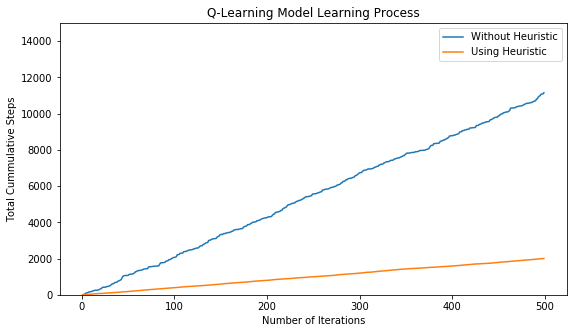

In [14]:
plt.figure(figsize = (20,5))
plt.subplot(1,2,1)
plt.ylim(0,15000)
plt.plot(range(1,500),Learning_step_bi, label = 'Without Heuristic')
plt.plot(range(1,500),Learning_step_ai, label = 'Using Heuristic')
plt.title('Q-Learning Model Learning Process')
plt.xlabel('Number of Iterations')
plt.ylabel('Total Cummulative Steps')
plt.legend()
plt.show()

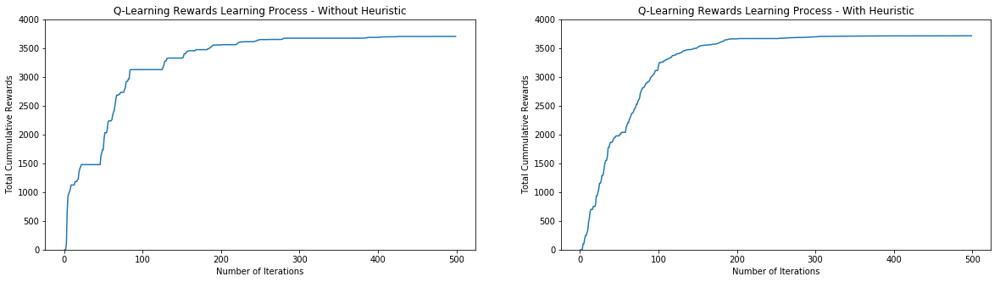

In [15]:
plt.figure(figsize = (20,5))
plt.subplot(1,2,1)
plt.ylim(0,4000)
plt.plot(range(1,500),rewards_curve_bi)
plt.title('Q-Learning Rewards Learning Process - Without Heuristic')
plt.xlabel('Number of Iterations')
plt.ylabel('Total Cummulative Rewards')

plt.subplot(1,2,2)
plt.ylim(0,4000)
plt.plot(range(1,500),rewards_curve_ai)
plt.title('Q-Learning Rewards Learning Process - With Heuristic')
plt.xlabel('Number of Iterations')
plt.ylabel('Total Cummulative Rewards')

plt.show()

## From the above two graphs we can conclude the following:
- Q-Learning with Heuristic function learning more better than then simple Q-Learning
- Q-Learning without Heuristic converges after 300 episodes where as Q-Learning with Heuristic converges after 200 episodes

## Deploying the agent

In [16]:
def deploy_agent(init_state,q_table):
    print("start state:", init_state)
    state = init_state
    steps = 0
    while True:
        steps = steps + 1
        action = np.argmax(q_table[state,:])
        print(action)
        state = action
        if action == 5:
            print('Goal Reached!')
            return steps

## Testing the Agent

In [17]:
Start_state = 8
steps = deploy_agent(Start_state,q_matrix)
print("Number of Steps took by Agent to reach Goal:",steps)

start state: 8
9
3
1
5
Goal Reached!
Number of Steps took by Agent to reach Goal: 4


## Evaluation Metrics for Q-Learning Model
- Updated Q-Table 
    - Initally Q table is Initialied with zeroes, once the training is completed, Q-Table is updated with the Maximum rewards for the each state, action pair which helps the agent to choose the best action in that particular state
- Rewards Learning
    - For each episode , reward is calculated and updated Q-Table and the reward learning progress graph is shown above.
- Total Number of Timesteps for the complete Training process
    - Upon using the Heuristic fuction, the search process computing process is improved and Q-Table is updated with the Maximum rewards with the least number of Timesteps for episode.
- Total Regrets
    - Even upon the successful training, there will always be the chance of regrets for the agent not to choose the optimal path towards the goal. In our Q-learning model even after success training, we can see 1 regret for the state 6 in which agent miss to choose the optimal path and rather used more steps to reach the goal. 

## Conclusion
- Q-Learning Model using Heuristic function outperfom the Simple Q-Learning Model intems of performance. 
- We can see the huge reduction of total number of time steps for Q-Learning Model using Heuristic Function.
- Agent learns quickly in Q-Learning Model using Heuristic 